<a href="https://colab.research.google.com/github/Tushar1000x/Image_processing/blob/main/IP_LAB_5_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import cv2
import numpy as np

# -------------------------------
# Parameters
# -------------------------------
video_path = "video.mp4"              # Input video file
output_video_path = "output_with_flow.mp4"  # Output video file
frame_width = 640
frame_height = 480
fps = 15

# -------------------------------
# Setup
# -------------------------------
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    raise FileNotFoundError(f"Cannot open video file: {video_path}")

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, fps, (frame_width, frame_height))

sift = cv2.SIFT_create()

# -------------------------------
# Read first frame
# -------------------------------
ret, old_frame = cap.read()
if not ret:
    raise RuntimeError("Failed to read from video file.")

old_frame = cv2.resize(old_frame, (frame_width, frame_height))
old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)
kp, des = sift.detectAndCompute(old_gray, None)

if len(kp) == 0:
    raise RuntimeError("No SIFT keypoints found in the first frame.")

p0 = np.array([pt.pt for pt in kp], dtype=np.float32).reshape(-1, 1, 2)

# -------------------------------
# Optical Flow Loop
# -------------------------------
while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame = cv2.resize(frame, (frame_width, frame_height))
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Track features
    p1, st, err = cv2.calcOpticalFlowPyrLK(old_gray, frame_gray, p0, None)

    # Redetect if tracking fails
    if p1 is None or st is None or len(p1[st == 1]) < 10:
        kp, des = sift.detectAndCompute(frame_gray, None)
        if kp:
            p0 = np.array([pt.pt for pt in kp], dtype=np.float32).reshape(-1, 1, 2)
            old_gray = frame_gray.copy()
        continue

    good_new = p1[st == 1]
    good_old = p0[st == 1]

    # Draw flow on original frame
    output_frame = frame.copy()
    total_magnitude = 0

    for new_pt, old_pt in zip(good_new, good_old):
        a, b = new_pt.ravel()
        c, d = old_pt.ravel()
        flow_vec = new_pt - old_pt
        mag = np.linalg.norm(flow_vec)
        total_magnitude += mag

        # Draw arrow
        output_frame = cv2.arrowedLine(output_frame, (int(c), int(d)), (int(a), int(b)), (0, 255, 0), 2, tipLength=0.3)

    avg_magnitude = total_magnitude / len(good_old)
    cv2.putText(output_frame, f"Avg Motion: {avg_magnitude:.2f}", (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    out.write(output_frame)

    old_gray = frame_gray.copy()
    p0 = good_new.reshape(-1, 1, 2)

# -------------------------------
# Cleanup
# -------------------------------
cap.release()
out.release()
print("✅ Output saved as:", output_video_path)


✅ Output saved as: output_with_flow.mp4


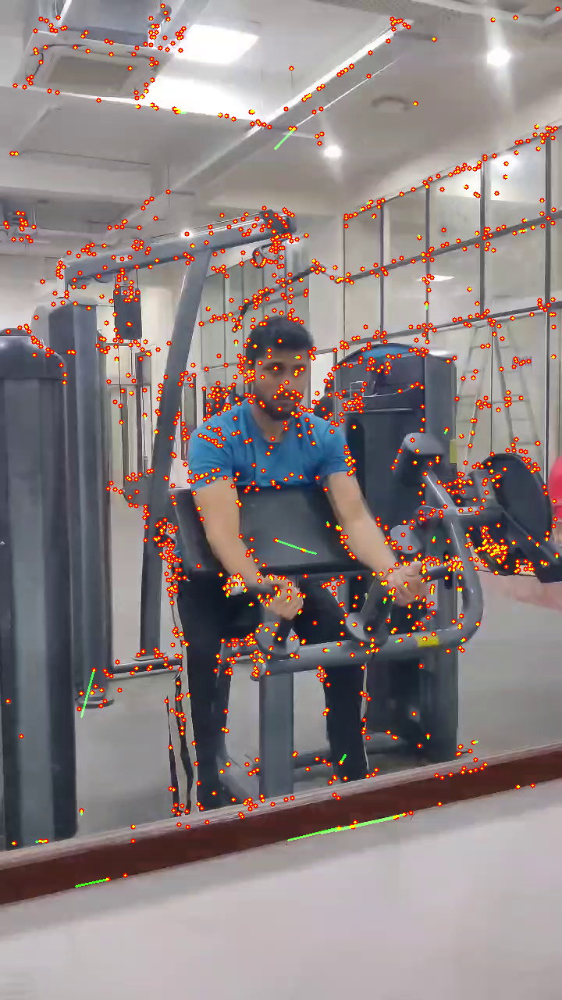

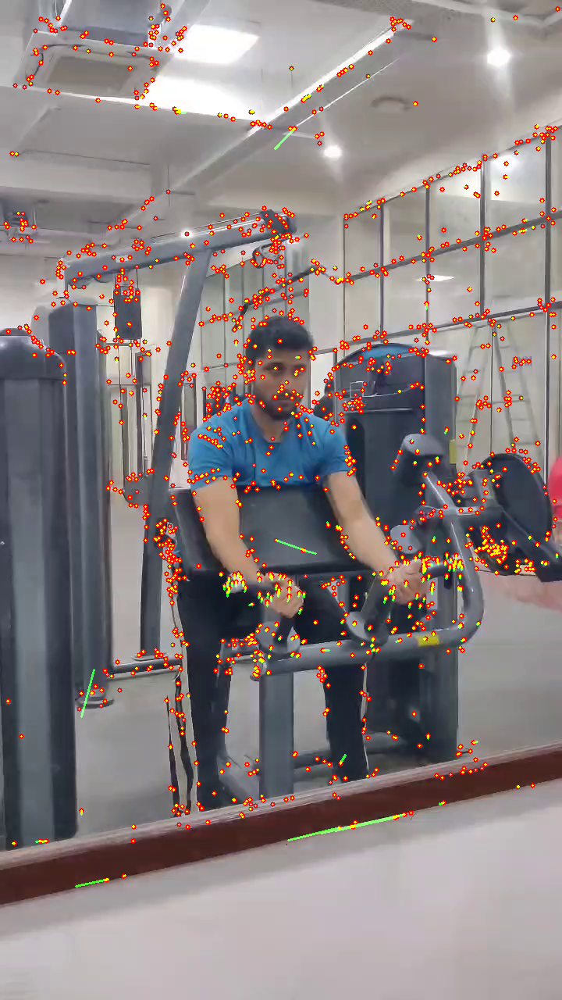

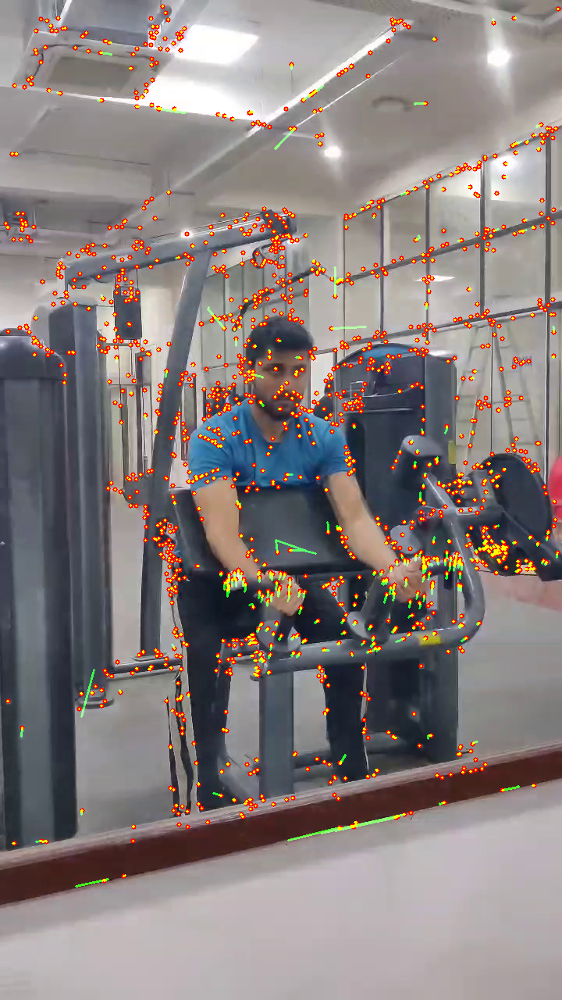

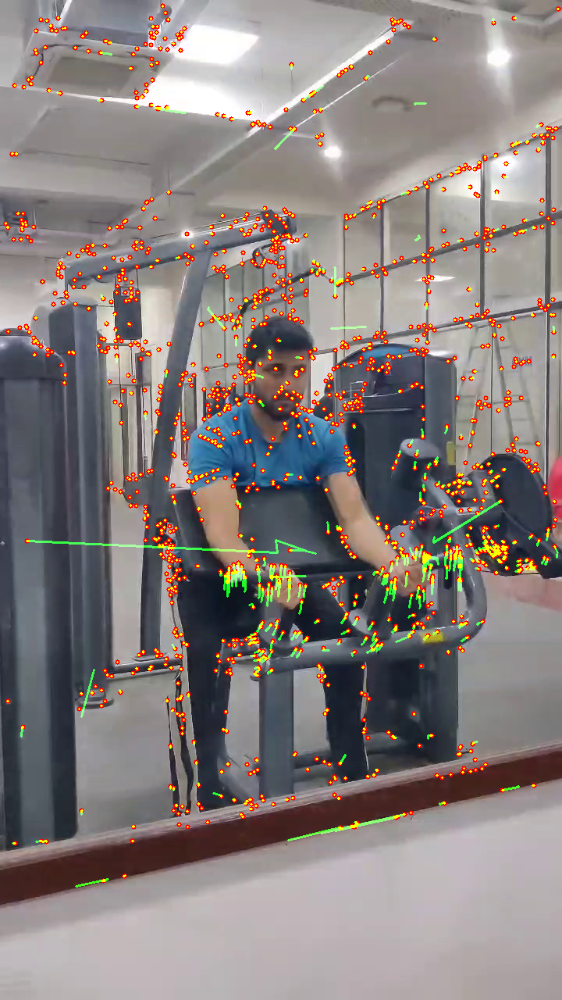

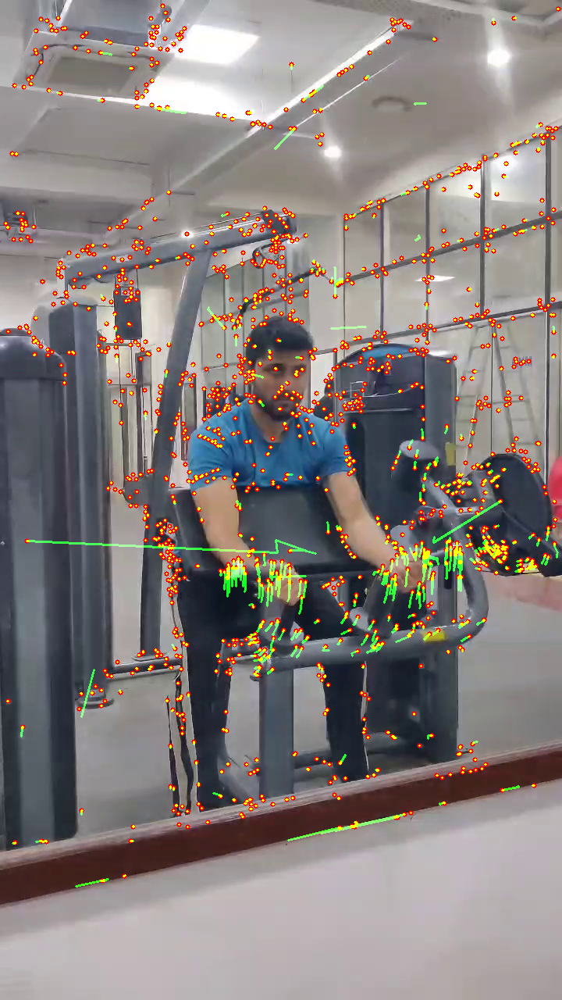

...

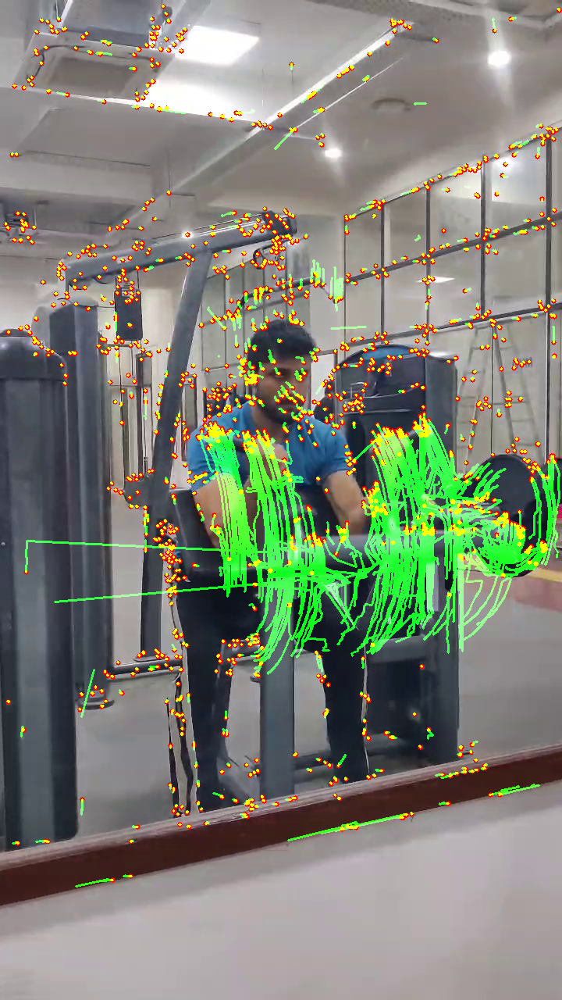

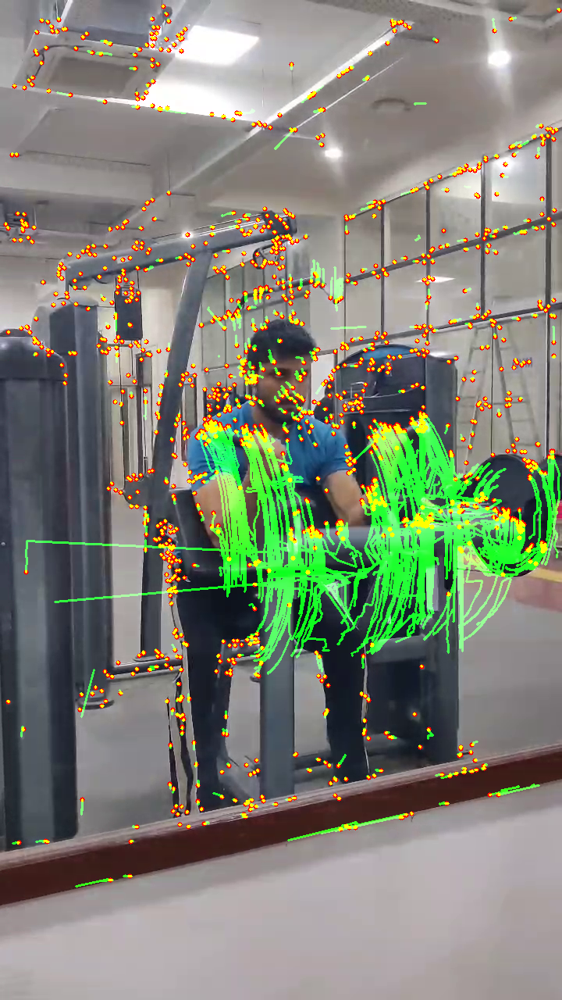

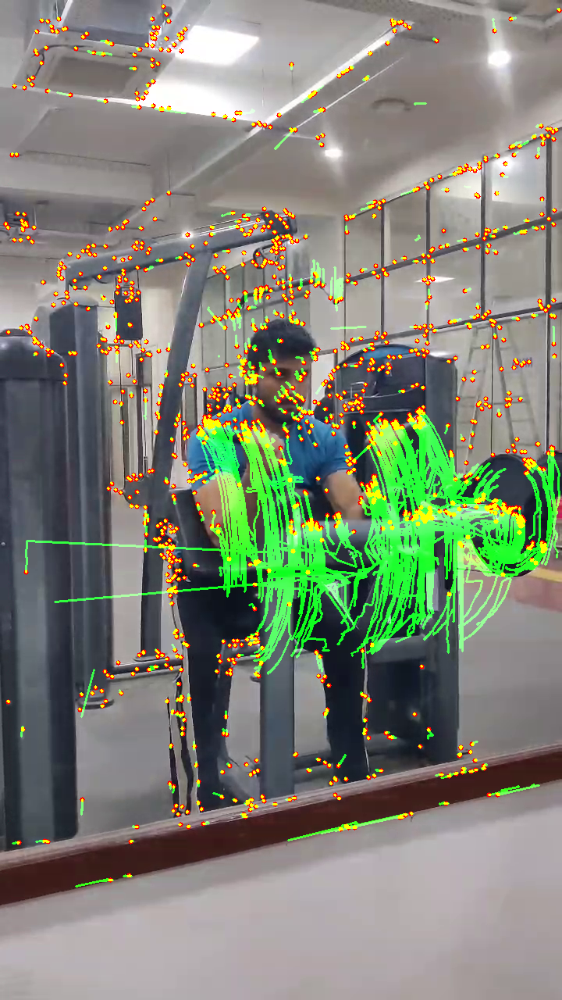

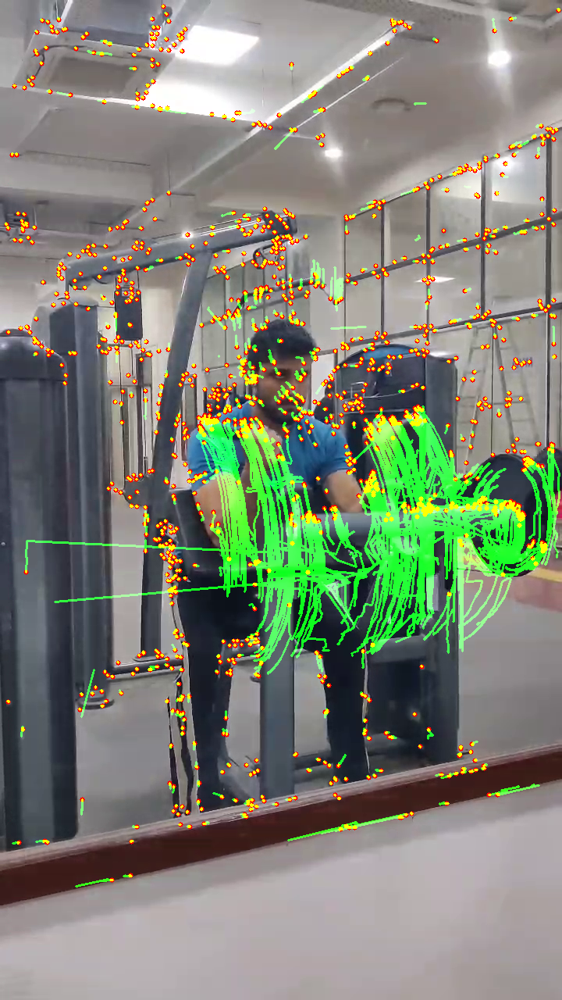

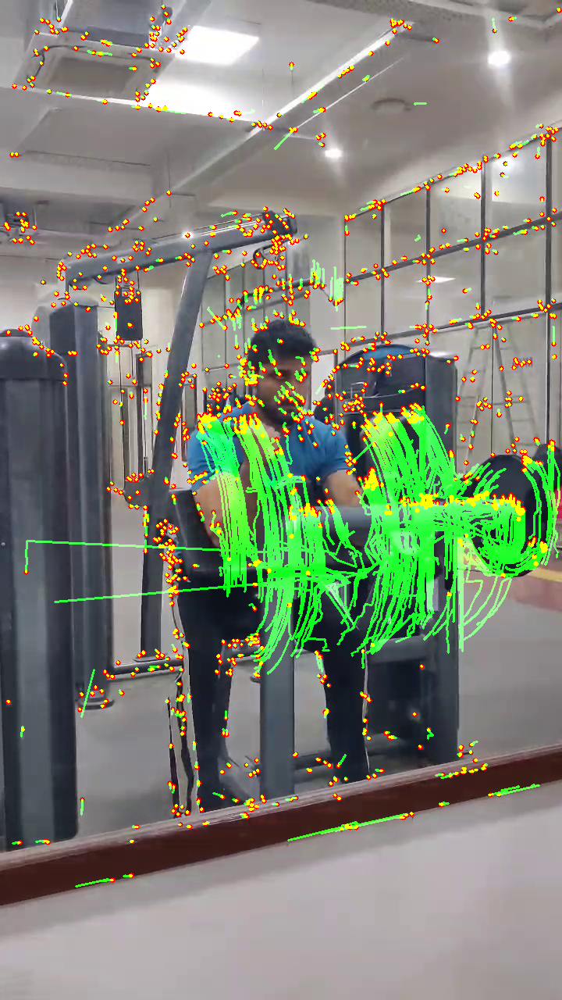

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow  # <-- required for displaying images in Colab

# Load video
cap = cv2.VideoCapture('video.mp4')

# Create SIFT detector
sift = cv2.SIFT_create()

# Parameters for Lucas-Kanade optical flow
lk_params = dict(winSize=(15, 15), maxLevel=2,
                 criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

# Read first frame
ret, old_frame = cap.read()
old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)

# Detect SIFT keypoints and convert to points
kp = sift.detect(old_gray, None)
old_points = np.array([k.pt for k in kp], dtype=np.float32).reshape(-1, 1, 2)

mask = np.zeros_like(old_frame)  # for drawing flow tracks

frame_count = 0  # Limit the number of frames shown to avoid overloading

while True:
    ret, frame = cap.read()
    if not ret or frame_count > 30:  # Show only first 30 frames
        break

    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Compute Optical Flow for SIFT keypoints
    new_points, status, error = cv2.calcOpticalFlowPyrLK(old_gray, frame_gray, old_points, None, **lk_params)

    # Select good points
    good_new = new_points[status == 1]
    good_old = old_points[status == 1]

    # Draw the tracks
    for i, (new, old) in enumerate(zip(good_new, good_old)):
        a, b = new.ravel()
        c, d = old.ravel()
        mask = cv2.line(mask, (int(a), int(b)), (int(c), int(d)), (0, 255, 0), 2)
        frame = cv2.circle(frame, (int(a), int(b)), 3, (0, 0, 255), -1)

    output = cv2.add(frame, mask)
    cv2_imshow(output)

    old_gray = frame_gray.copy()
    old_points = good_new.reshape(-1, 1, 2)

    frame_count += 1

cap.release()